In [2]:
import sys
import numpy as np
from numpy import genfromtxt
import tkinter as tk
from tkinter import filedialog
import os
import pandas as pd
import matplotlib.pyplot as plt
import scipy.signal as signal
from scipy import interpolate
from scipy.optimize import curve_fit
from scipy.interpolate import UnivariateSpline
from scipy import stats
from ipfx import feature_extractor
from ipfx import subthresh_features as subt
from ipfx import feature_vectors as fv
from ipfx.sweep import Sweep
from sklearn.preprocessing import minmax_scale
from pyAPisolation.loadABF import loadABF
import sklearn.preprocessing
import pyabf
import logging
import glob
method='trf'

C:\Users\SMest\Anaconda3\lib\site-packages\numpy\_distributor_init.py:32: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\SMest\Anaconda3\lib\site-packages\numpy\.libs\libopenblas.4SP5SUA7CBGXUEOC35YP2ASOICYYEQZZ.gfortran-win_amd64.dll
C:\Users\SMest\Anaconda3\lib\site-packages\numpy\.libs\libopenblas.QVLO2T66WEPI7JZ63PS3HMOHFEY472BC.gfortran-win_amd64.dll
  stacklevel=1)


In [3]:
import autograd.numpy as np
from autograd import grad



In [4]:

def exp_grow(t, a, b, alpha):
    return a - b * np.exp(-alpha * t)

def exp_grow_2p(t, a, b1, alphaFast, b2, alphaSlow):
    return a - b1 * np.exp(-alphaFast * t) - b2*np.exp(-alphaSlow*t) 

def exp_grow_gp(t, Y0, Plateau, PercentFast, KFast, KSlow):
    #graphpad style two phase decay
    SpanFast=(Y0-Plateau)*PercentFast*.01

    SpanSlow=(Y0-Plateau)*(100-PercentFast)*.01

    return Plateau + SpanFast*np.exp(-KFast*t) + SpanSlow*np.exp(-KSlow*t)


In [5]:
def exp_growth_factor(dataT,dataV,dataI, end_index=300):
    #try:
        
        diff_I = np.diff(dataI)
        upwardinfl = np.argmax(diff_I)

        #Compute out -50 ms from threshold
        dt = dataT[1] - dataT[0]
        offset = 0.01/ dt 

        end_index = int(end_index - offset)


        
        upperC = np.amax(dataV[upwardinfl:end_index])
        lowerC  = np.amin(dataV[upwardinfl:end_index])
        diffC = np.abs(lowerC - upperC)
        t1 = dataT[upwardinfl:end_index] - dataT[upwardinfl]
        curve = curve_fit(exp_grow, t1, dataV[upwardinfl:end_index], maxfev=50000, bounds=([-np.inf, -np.inf, -np.inf], [np.inf, np.inf, np.inf]))[0]
        #curve2 = curve_fit(exp_grow_2p, t1, dataV[upwardinfl:end_index], maxfev=50000,method='trf', bounds=([upperC-5,  0, 10,  0,  -np.inf], [upperC+5, diffC, np.inf, diffC,np.inf]), #xtol=None, gtol=None, ftol=1e-12)[0]
        curve2 = curve_fit(exp_grow_gp, t1, dataV[upwardinfl:end_index], maxfev=50000,method='trf', bounds=([lowerC-5,  upperC-5, 50,  -np.inf,  -np.inf], [lowerC+5, upperC+5, 100,np.inf,np.inf]),  xtol=None, gtol=None, ftol=1e-12)[0]
        tau = curve[2]
        tau1 = 1/curve2[3]
        tau2 = 1/curve2[4]
        tau_idx = [3, 4]
        fast = tau_idx[np.argmin([tau1, tau2])]
        slow = tau_idx[np.argmax([tau1, tau2])]
        
        curve_out = [curve2[0], curve2[2], curve2[fast], 100-curve2[2], curve2[slow]]


        #plt.subplot(1,2,1)
        plt.plot(t1, dataV[upwardinfl:end_index], c='k', alpha=0.5)
        plt.plot(t1, exp_grow_gp(t1, *curve2), label=f'2 phase fit', c='r', alpha=0.5)
        plt.plot(t1, exp_grow(t1, *curve_out[:3]), label=f'Fast phase', c='g', alpha=0.5)
        plt.plot(t1, exp_grow(t1, curve_out[0], *curve_out[3:]), label=f'slow phase', c='b', alpha=0.5)
        plt.title(f" CELL will tau1 {1/curve2[fast]} and tau2 {1/curve2[slow]}")
        #plt.subplot(1,2,2)
        plt.legend()
        #plt.twinx()
        #plt.subplot(1,2,2)
        dy = curve_detrend(t1, dataV[upwardinfl:end_index], curve2)
         #signal.savgol_filter(nt1p.diff(dataV[upwardinfl:end_index])/np.diff(t1), 71, 2, mode='mirror')
        #plt.plot(t1,dy)
        
        curve_out = [curve2[0], curve2[fast-1], 1/curve2[fast], curve2[slow-1], 1/curve2[slow]]
        return curve_out, np.amax(dy)
    #except:
        return [np.nan, np.nan, np.nan, np.nan, np.nan]

In [6]:


f1 = grad(exp_grow_2p)  # 1st derivative of f
f2 = grad(f1) # 2nd derivative of f

def curvature(x, a, b1, alphaFast, b2, alphaSlow):
        return np.abs(f2(x, a, b1, alphaFast, b2, alphaSlow))*(1 + f1(x, a, b1, alphaFast, b2, alphaSlow)**2)**-1.5
    
    
def curvature_real(dy, ddy):
        return abs(dy)*(1 + ddy**2)**-1.5
    
def curvature_splines(x, y=None, error=0.1, smoothing=None):
    """Calculate the signed curvature of a 2D curve at each point
    using interpolating splines.
    Parameters
    ----------
    x,y: numpy.array(dtype=float) shape (n_points, )
         or
         y=None and
         x is a numpy.array(dtype=complex) shape (n_points, )
         In the second case the curve is represented as a np.array
         of complex numbers.
    error : float
        The admisible error when interpolating the splines
    Returns
    -------
    curvature: numpy.array shape (n_points, )
    Note: This is 2-3x slower (1.8 ms for 2000 points) than `curvature_gradient`
    but more accurate, especially at the borders.
    """

    # handle list of complex case
    if y is None:
        x, y = x.real, x.imag

    t = np.arange(x.shape[0])
    std = error * np.ones_like(x)

    fx = UnivariateSpline(t, x, k=4, w=1 / np.sqrt(std), s=smoothing)
    fy = UnivariateSpline(t, y, k=4, w=1 / np.sqrt(std), s=smoothing)

    xˈ = fx.derivative(1)(t)
    xˈˈ = fx.derivative(2)(t)
    yˈ = fy.derivative(1)(t)
    yˈˈ = fy.derivative(2)(t)
    curvature = (xˈ* yˈˈ - yˈ* xˈˈ) / np.power(xˈ** 2 + yˈ** 2, 3 / 2)
    return curvature
    

def derivative(x,y):
    return np.diff(y)/np.diff(x)


def curve_detrend(x,y, curve2):
    test = curvature_splines(x, signal.savgol_filter(y, 51, 1), error=1, smoothing=25)
    cy = np.array([curvature(xi, *curve2) for xi in x])
    #detrend using first and last point
    lin_res = stats.linregress([x[0], x[-1]], [cy[0], cy[-1]])
    trend = x*lin_res.slope + lin_res.intercept
    #plt.plot(x,trend)
    detrended_data = cy - trend
    return detrended_data

In [7]:
files = glob.glob('C:\\Users\\SMest\\Documents\\clustering-data\\\All IC1s\\*.abf', recursive=True)

In [8]:
cell_type_df = pd.read_csv("C:\\Users\\SMest\\Documents\\clustering-data\\MARM_PVN_IC1\\spike_count_sort_out.csv")
print(cell_type_df.head)
file_names = cell_type_df['filename'].to_numpy()
cell_type_label = cell_type_df['cell_label'].to_numpy()

<bound method NDFrame.head of             filename  label  cell_label  CRH_label  Sag Ratio 001  \
0    2020_01_16_0003      2          -1         -1       0.072335   
1    2020_01_16_0011      1           1         -1       0.053301   
2    2020_01_16_0020      2           3         -1       0.183200   
3    2020_01_16_0025      2          -1         -1       0.200844   
4    2020_01_16_0029      0          -1          0       0.044166   
..               ...    ...         ...        ...            ...   
152         21311038      1           0         -1       0.065753   
153         21311047      1           1         -1       0.069595   
154         21311063      5           1         -1       0.291042   
155         21311074      1          -1         -1       0.123829   
156         21311084      1           1         -1       0.290186   

     Sag Ratio 002  Sag Ratio 003  Sag Ratio 004  Sag Ratio 005  \
0         0.480277       1.081981       1.528664       1.856069   
1      

0
1
[[-70.9051  24.4667   0.0043 ...   0.0409   0.1046   0.2666]]
(7,)


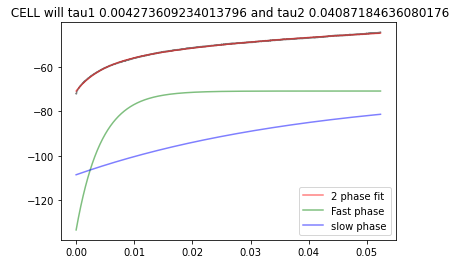

2
[[-121.445    82.5704    0.0474 ...    0.0474    1.        0.2556]]
(7,)


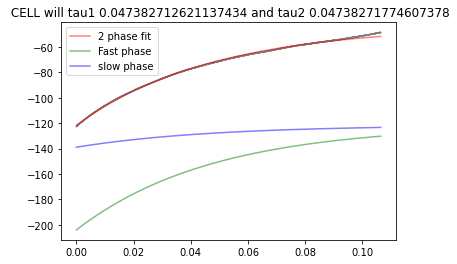

3
[[-90.1646  50.       0.0434 ...   0.0857   0.5066   0.2334]]
(7,)


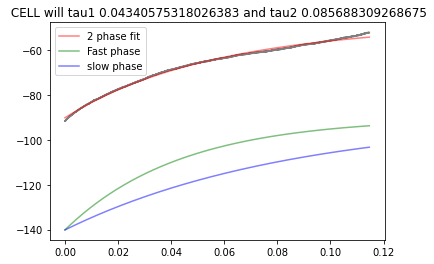

4
[[-91.6886  77.3541   0.0726 ...   0.0726   1.       0.1782]]
(7,)


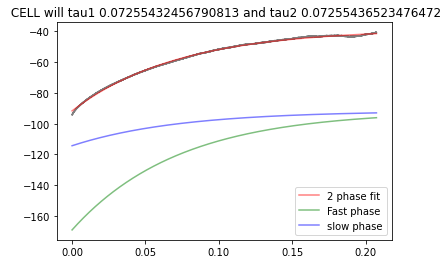

5
6
[[-73.9414  25.4425   0.0393 ...   0.0393   1.       3.8397]]
(7,)


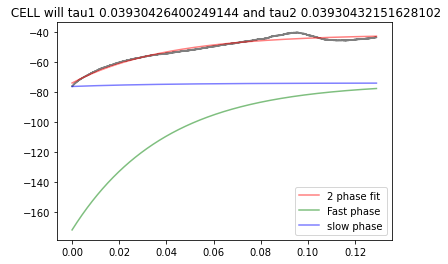

7
8
9
[[-68.6175  58.5586   0.0068 ...   0.0625   0.1083   0.2733]]
(7,)


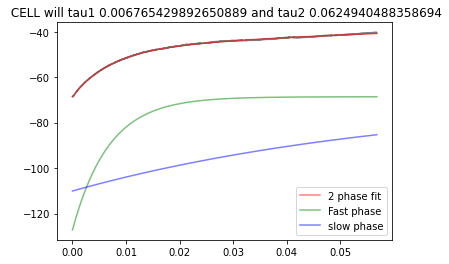

10
[[-76.5534  25.3585   0.0172 ...   0.0394   0.4352   0.8582]]
(7,)


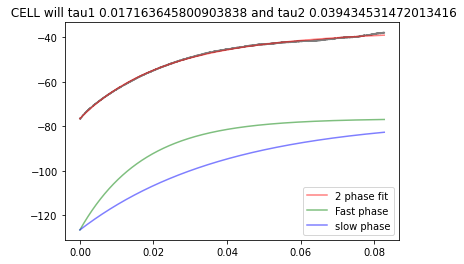

11
[[-77.9413  99.9926   0.0234 ...   0.0234   1.       0.4279]]
(7,)


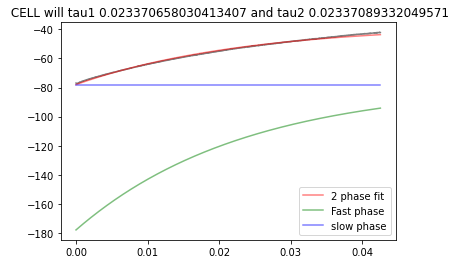

12
13
[[-74.0389  26.7191   0.0099 ...   0.0374   0.2653   0.4965]]
(7,)


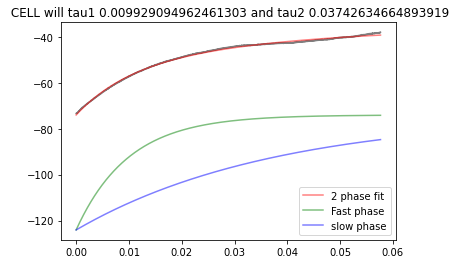

14
[[-78.5038  59.7502   0.0149 ...   0.2521   0.0593   0.0664]]
(7,)


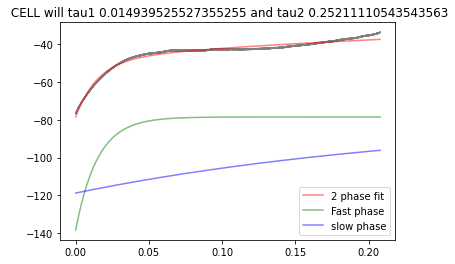

15
[[-75.1347  55.5864   0.0084 ...   0.176    0.0478   0.1022]]
(7,)


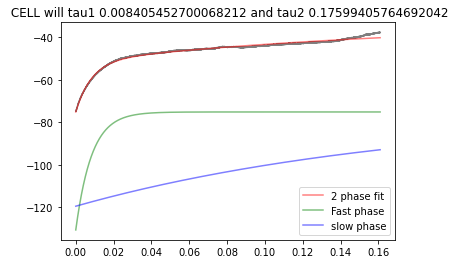

16
17
[[-69.7459  64.2021   0.0156 ...   0.0156   1.       1.4817]]
(7,)


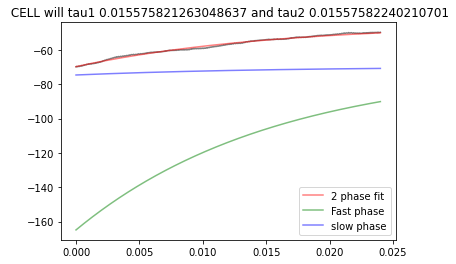

18
[[-82.0055  50.       0.032  ...   0.1944   0.1648   0.1029]]
(7,)


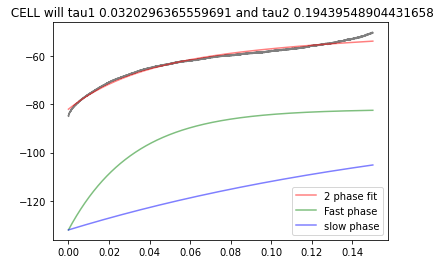

19
[[-81.039   50.       0.0266 ...   0.337    0.0788   0.0594]]
(7,)


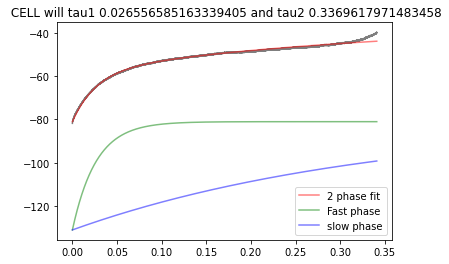

20
[[-89.7315  88.1547   0.045  ...   0.045    1.       0.2522]]
(7,)


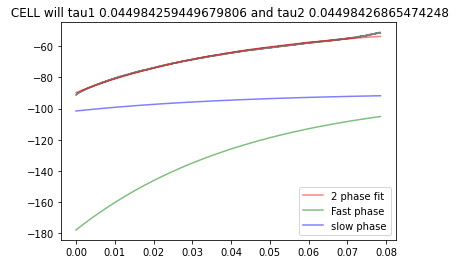

21
[[-73.4626  83.709    0.0868 ...   0.0868   1.       0.1376]]
(7,)


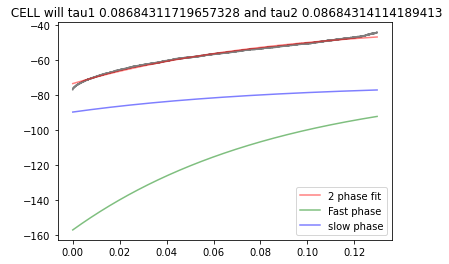

22
[[-67.2373  50.       0.0031 ...   0.0157   0.1946   1.2727]]
(7,)


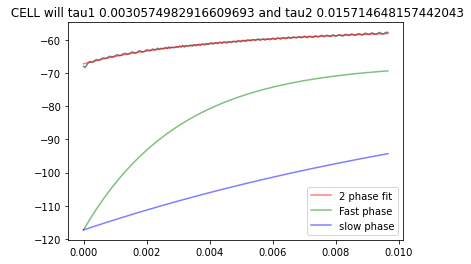

23
[[-75.8087  50.       0.015  ...   0.1195   0.1258   0.1674]]
(7,)


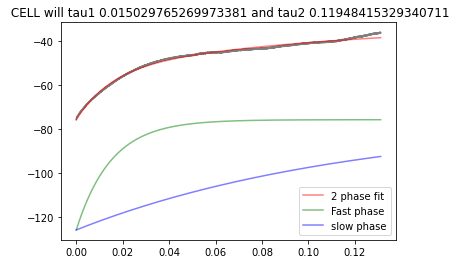

24
[[-68.4515  50.       0.006  ...   0.0153   0.3922   1.3081]]
(7,)


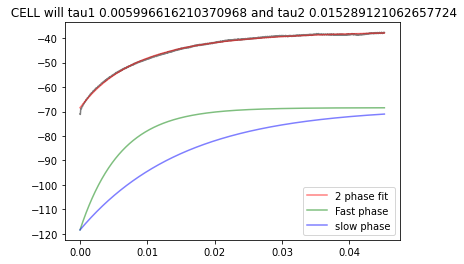

25
[[-70.3954  17.5737   0.0097 ...   0.0569   0.1701   0.7154]]
(7,)


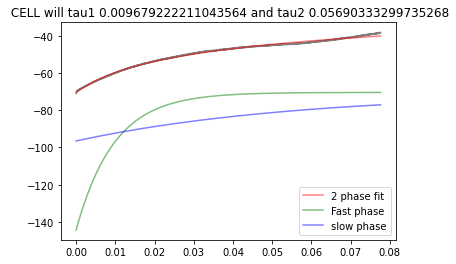

26
[[-74.1515  63.9371   0.0165 ...   0.2142   0.077    0.073 ]]
(7,)


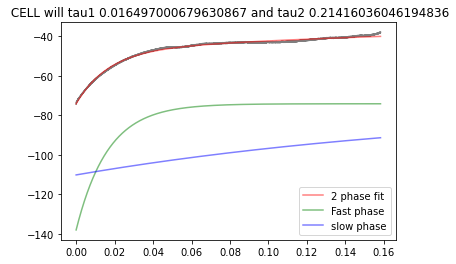

27
[[-75.9268  55.7708   0.0072 ...   0.1521   0.0472   0.1179]]
(7,)


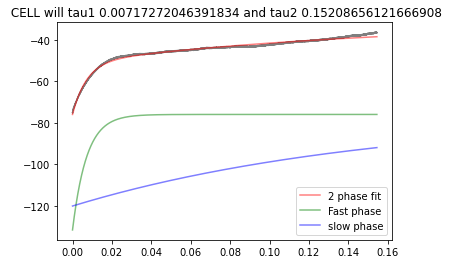

28
[[-78.6699  10.2555   0.0144 ...   0.0975   0.1474   0.7186]]
(7,)


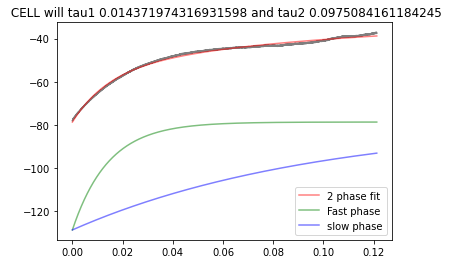

29
[[-82.1276  12.0863   0.0211 ...   0.0827   0.2554   1.4533]]
(7,)


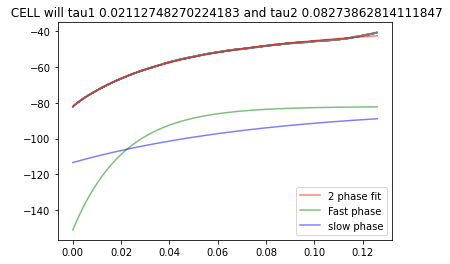

30
[[-77.8997   7.8631   0.0161 ...   0.1272   0.1265   0.8296]]
(7,)


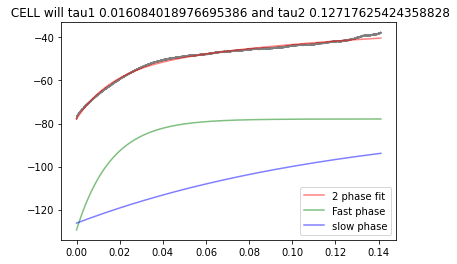

31
[[-72.6324   1.6732   0.0096 ...   0.5976   0.0161   0.4803]]
(7,)


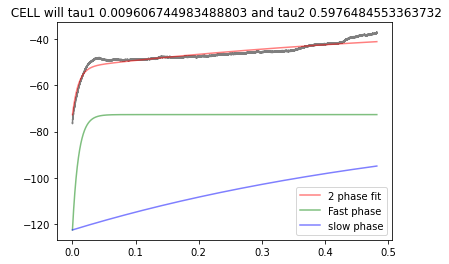

32
[[-86.8089  67.8216   0.0236 ...   0.8564   0.0275   0.0172]]
(7,)


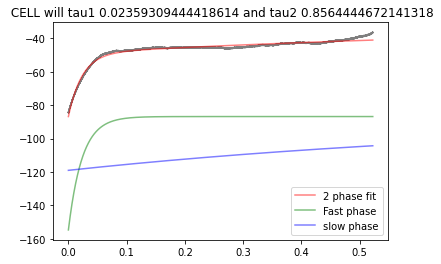

33
34
35
[[-96.0221   7.4193   0.1348 ...   0.1348   1.      10.3912]]
(7,)


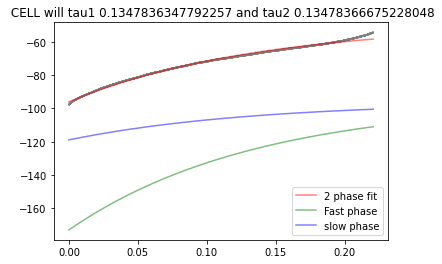

36
37
[[-83.1071  83.0718   0.0538 ...   0.0538   1.       0.2236]]
(7,)


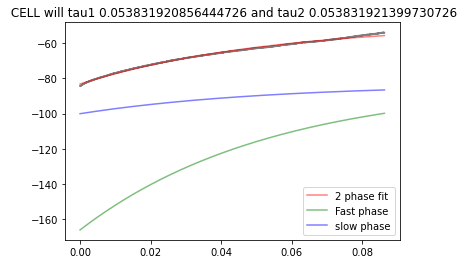

38
fail
39
[[-78.0045   1.6163   0.025  ...   0.6187   0.0404   1.3271]]
(7,)


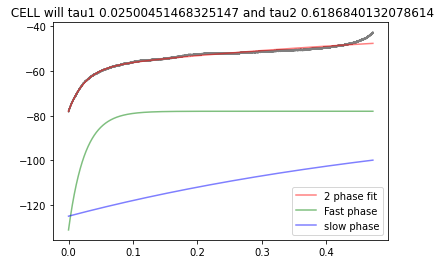

40
[[-86.7694   1.624    0.0193 ...   0.6158   0.0313   0.999 ]]
(7,)


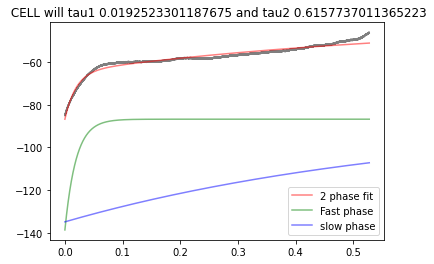

41
[[-96.0437   6.4603   0.0188 ...   0.1548   0.1212   0.9381]]
(7,)


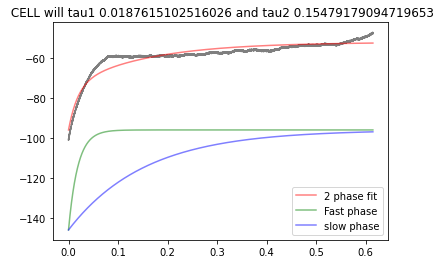

42
[[-96.9559  30.7334   0.0325 ...   0.0325   1.       2.841 ]]
(7,)


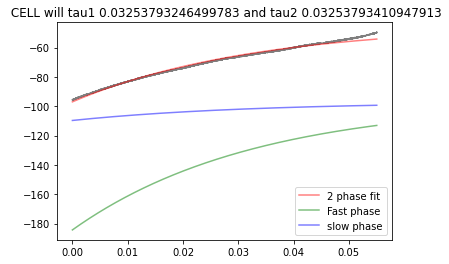

43
[[-94.4684  12.6819   0.0064 ...   0.0789   0.0806   0.5754]]
(7,)


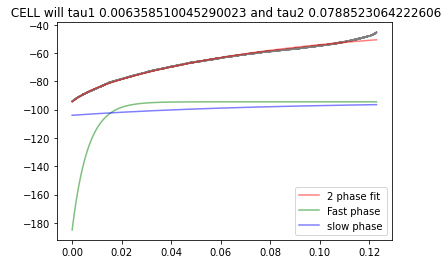

44
[[-84.1887  22.9688   0.0107 ...   0.0435   0.246    0.9562]]
(7,)


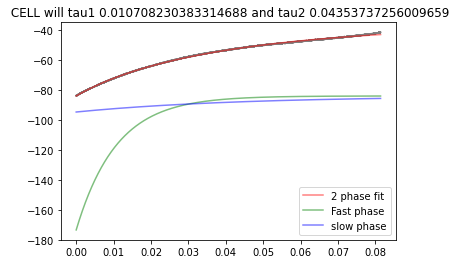

45
46
47
[[-91.2734  11.4041   0.0231 ...   0.0877   0.263    1.1529]]
(7,)


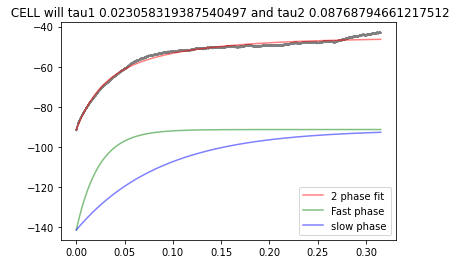

48
[[-81.5741  50.       0.0289 ...   0.2168   0.1334   0.0923]]
(7,)


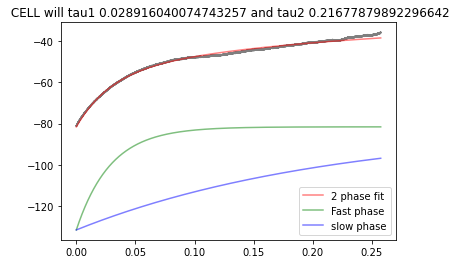

49
[[-91.6124   4.7238   0.0235 ...   0.2117   0.1112   1.1771]]
(7,)


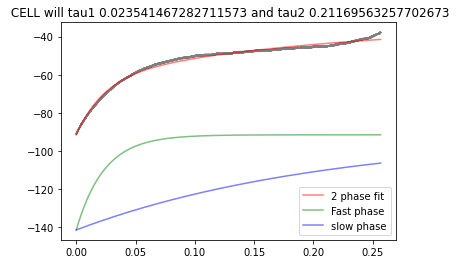

50
[[-85.3132   9.0177   0.0162 ...   0.1109   0.1461   0.8099]]
(7,)


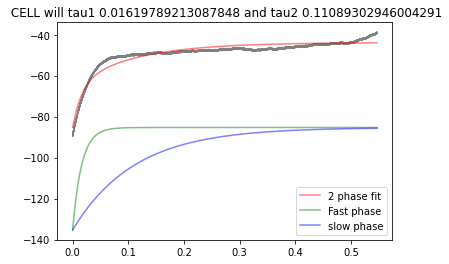

51
[[-104.0369   50.        0.0579 ...    0.1708    0.3389    0.1171]]
(7,)


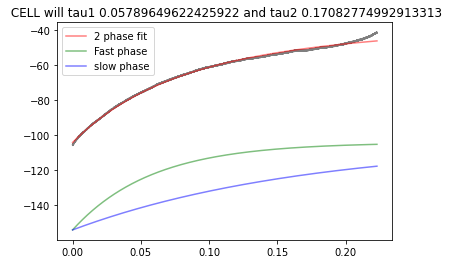

52
[[-106.3268   89.2411    0.0235 ...    2.0276    0.0116    0.0055]]
(7,)


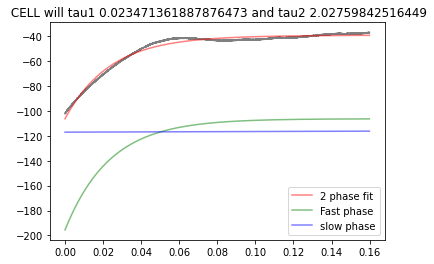

53
[[-85.4433  16.7414   0.0141 ...   0.0597   0.2353   1.1701]]
(7,)


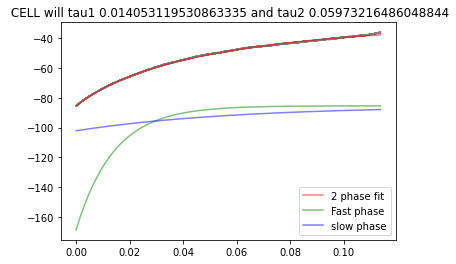

54
55
56
[[-129.3834    6.177     0.0324 ...    0.1619    0.2004    2.3167]]
(7,)


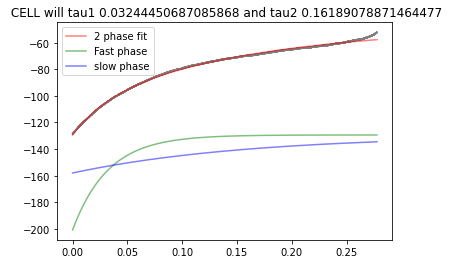

57
[[-98.1493  90.1328   0.0556 ...   0.0556   1.       0.1997]]
(7,)


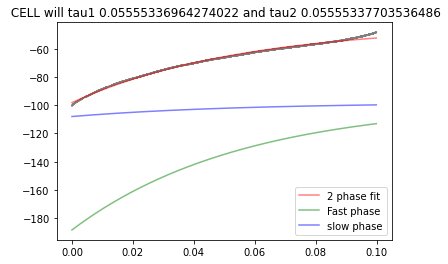

58
[[-91.8815  72.9727   0.021  ...   0.1359   0.1543   0.1008]]
(7,)


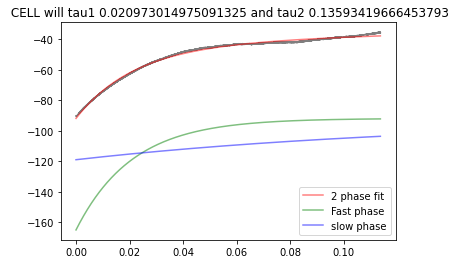

59
[[-76.334   62.3614   0.0099 ...   0.1179   0.0839   0.1361]]
(7,)


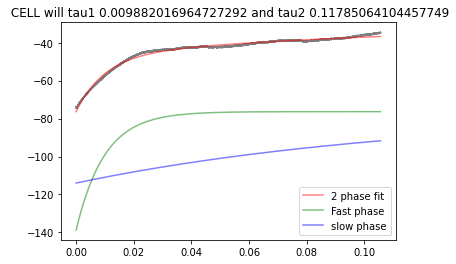

60
[[-80.8816  97.6247   0.0329 ...   0.0329   1.       0.3112]]
(7,)


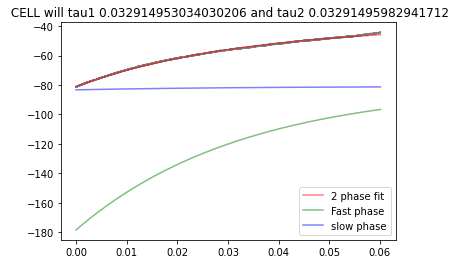

61
[[-85.7656  50.       0.0458 ...   0.1127   0.406    0.1774]]
(7,)


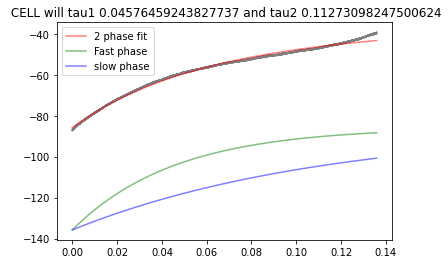

62
63
[[-83.7794  60.5796   0.0248 ...   0.2309   0.1076   0.0715]]
(7,)


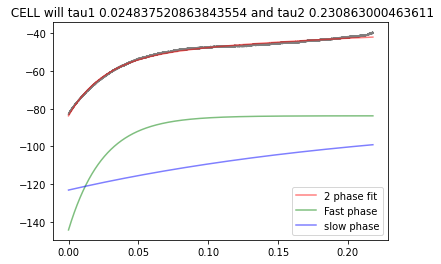

64
[[-87.9871   8.8955   0.0114 ...   0.1124   0.1013   0.5695]]
(7,)


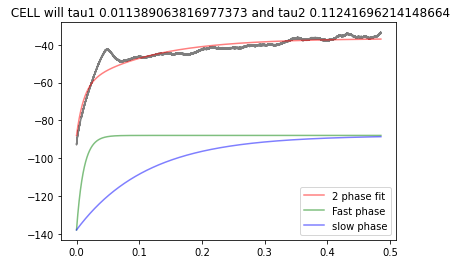

65
[[-93.5413  50.       0.0446 ...   0.1583   0.2818   0.1263]]
(7,)


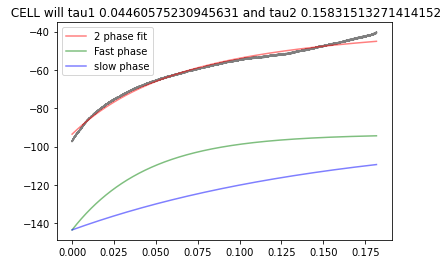

66
[[-88.9649  13.142    0.0761 ...   0.0761   1.       5.7131]]
(7,)


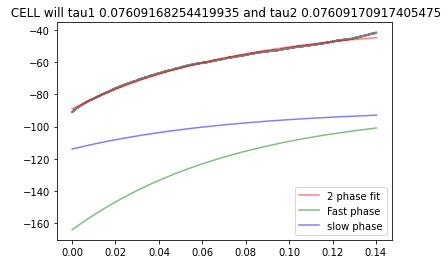

67
[[-87.7032  14.0275   0.0095 ...   0.0713   0.1339   0.8067]]
(7,)


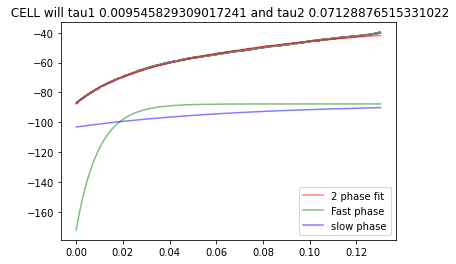

68
69
[[-88.3945   5.7538   0.024  ...   0.1738   0.1382   1.201 ]]
(7,)


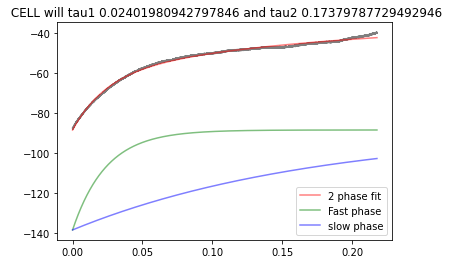

70
[[-88.9191   6.6184   0.0281 ...   0.1511   0.186    1.8781]]
(7,)


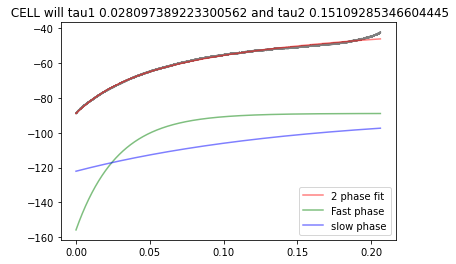

71
72
73
74
75
76
[[-91.5586   3.7095   0.0391 ...   0.2696   0.1449   2.5817]]
(7,)


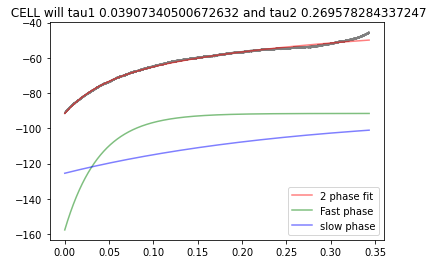

77
[[-88.8721  50.       0.1381 ...   0.4569   0.3022   0.0438]]
(7,)


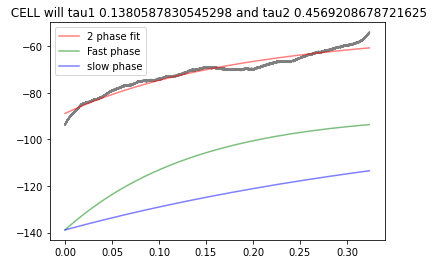

78
[[-96.8194  11.3175   0.0884 ...   0.0884   1.       7.4464]]
(7,)


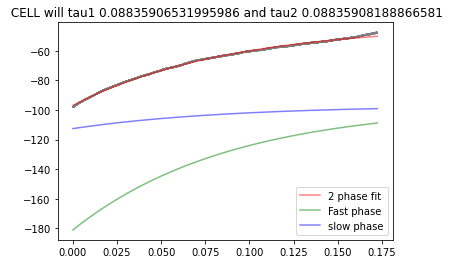

79
[[-108.3874   77.5709    0.0883 ...    0.0883    1.        0.146 ]]
(7,)


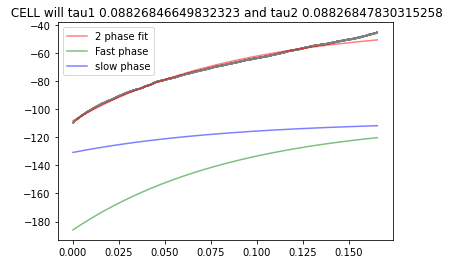

80
[[-103.7441   50.        0.1041 ...    0.4735    0.2198    0.0422]]
(7,)


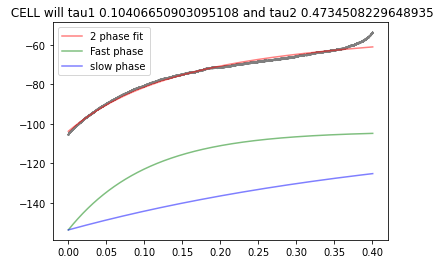

81
[[-97.7546  13.2248   0.0276 ...   0.0756   0.3649   2.1061]]
(7,)


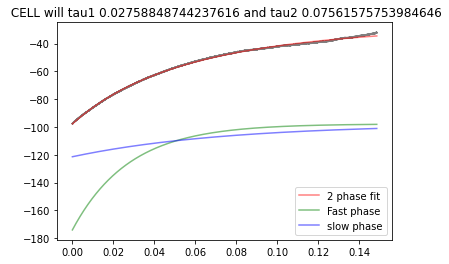

82
fail
83
[[-98.646   50.       0.0554 ...   0.1554   0.3564   0.1287]]
(7,)


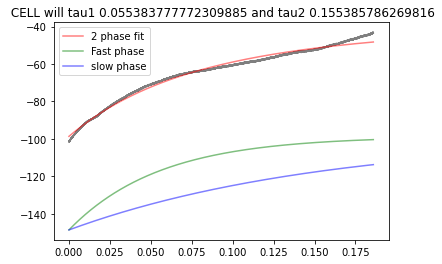

84
[[-86.3951  81.3207   0.0343 ...   0.0343   1.       0.359 ]]
(7,)


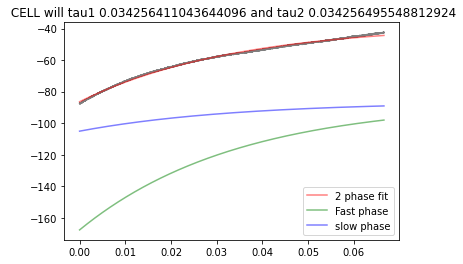

85
[[-98.1897  11.4695   0.0065 ...   0.0872   0.0744   0.5772]]
(7,)


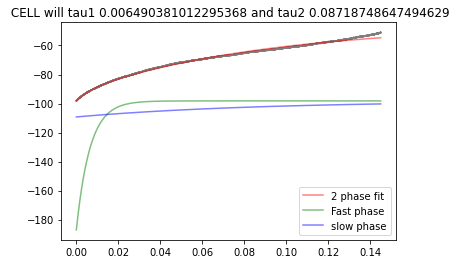

86
87
[[-94.9243  13.1391   0.0761 ...   0.0761   1.       6.0691]]
(7,)


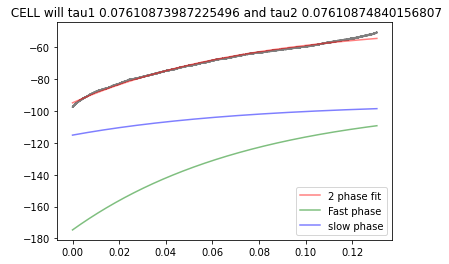

88
[[-87.5779  83.6656   0.1089 ...   0.1089   1.       0.1098]]
(7,)


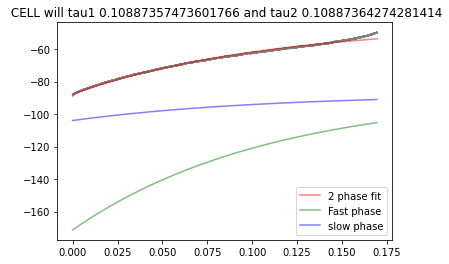

89
[[-112.6226    9.354     0.0179 ...    0.1069    0.1672    1.7189]]
(7,)


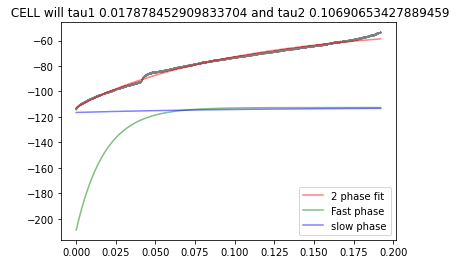

90
[[-107.1739   71.193     0.0257 ...    0.3405    0.0756    0.0413]]
(7,)


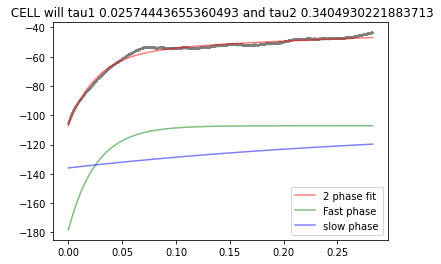

91
[[-83.7934  35.7721   0.0273 ...   0.028    0.9769   2.7308]]
(7,)


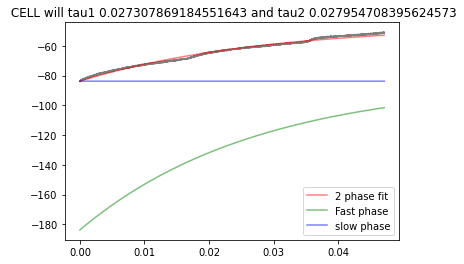

92
[[-127.0158   57.2056    0.0589 ...    0.3126    0.1883    0.0559]]
(7,)


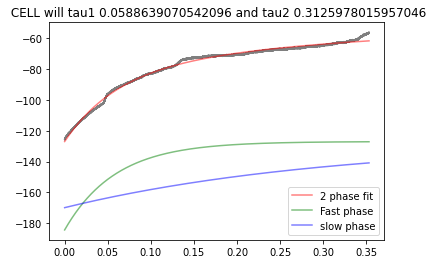

93
[[-95.1372  18.2352   0.0548 ...   0.0548   1.       4.6363]]
(7,)


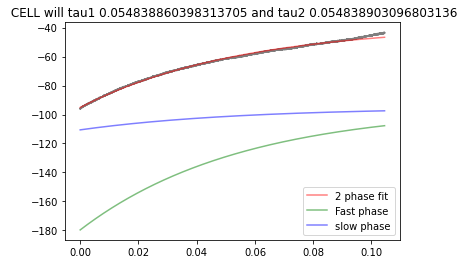

94
[[-99.7946  62.5072   0.0232 ...   0.3014   0.0771   0.0531]]
(7,)


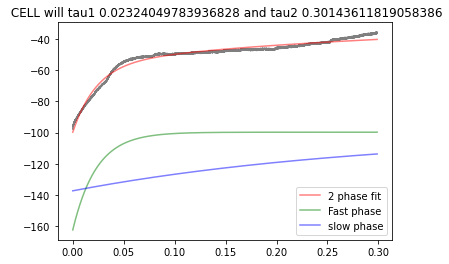

95
[[-75.9242  21.9878   0.0103 ...   0.0455   0.2264   0.7449]]
(7,)


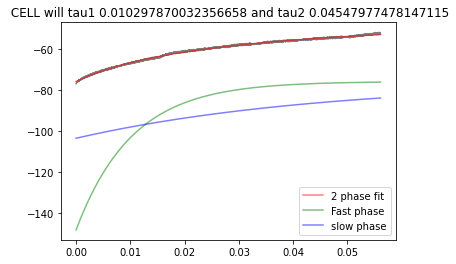

96
C:\Users\SMest\Anaconda3\lib\site-packages\scipy\optimize\_lsq\common.py:115: RuntimeWarning: overflow encountered in power
  phi_prime = -np.sum(suf ** 2 / denom**3) / p_norm
C:\Users\SMest\Anaconda3\lib\site-packages\scipy\optimize\_lsq\common.py:154: RuntimeWarning: invalid value encountered in double_scalars
  ratio = phi / phi_prime
C:\Users\SMest\Anaconda3\lib\site-packages\scipy\optimize\_lsq\trf.py:363: RuntimeWarning: divide by zero encountered in double_scalars
  alpha *= Delta / Delta_new
C:\Users\SMest\Anaconda3\lib\site-packages\scipy\optimize\_lsq\common.py:132: RuntimeWarning: divide by zero encountered in double_scalars
  alpha_upper = norm(suf) / Delta
[[-83.5878  21.376    0.0405 ...   0.0468   0.8648   4.0458]]
(7,)


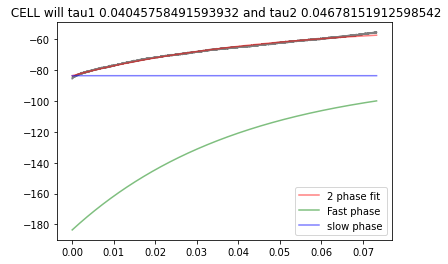

97
[[-91.8052  12.4035   0.0145 ...   0.0806   0.1797   1.227 ]]
(7,)


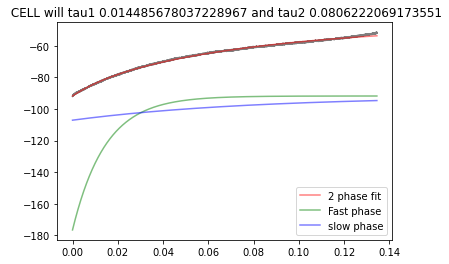

98
99
[[-84.4866  34.0848   0.0293 ...   0.0293   1.       2.8982]]
(7,)


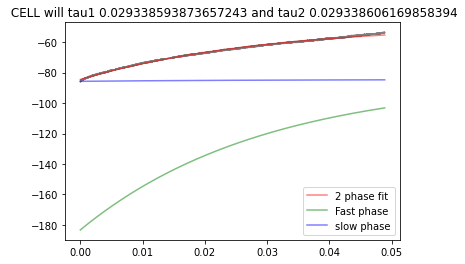

100
[[-83.9369   8.9744   0.0218 ...   0.1114   0.1955   1.1743]]
(7,)


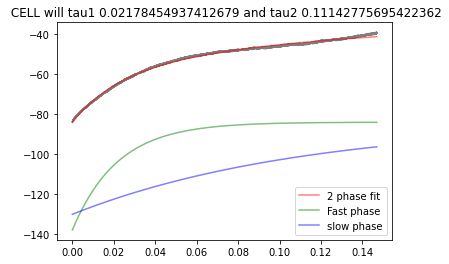

101
[[-80.9548  62.3596   0.0201 ...   0.1756   0.1142   0.0913]]
(7,)


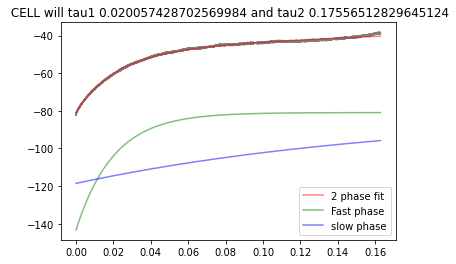

102
103
[[-77.7891  50.       0.0187 ...   0.063    0.2968   0.3176]]
(7,)


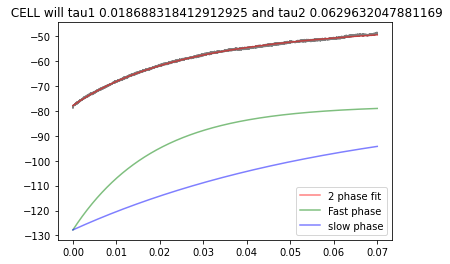

104
fail
105
[[-79.7578  23.3492   0.0034 ...   0.0428   0.0802   0.3201]]
(7,)


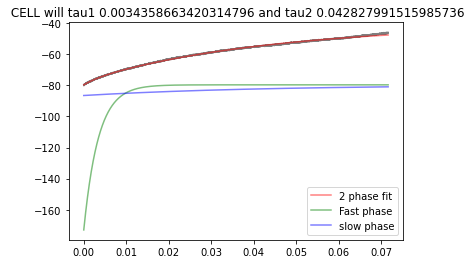

106
[[-89.1353  54.146    0.0252 ...   0.1958   0.1286   0.0943]]
(7,)


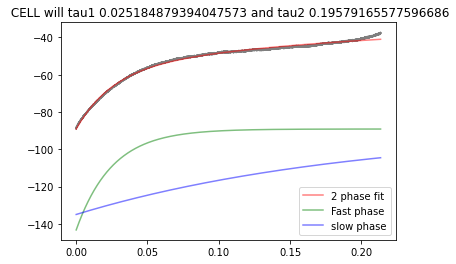

107
[[-96.6204  73.4246   0.0204 ...   0.3764   0.0543   0.0362]]
(7,)


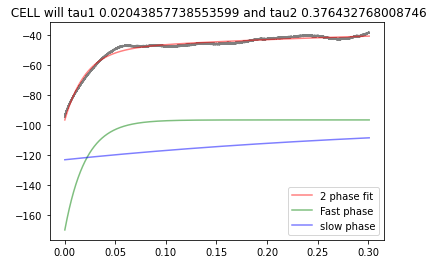

108
[[-102.283    87.3816    0.0494 ...    0.0494    1.        0.2316]]
(7,)


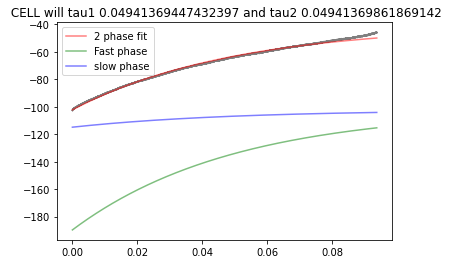

109
110
[[-72.2595  29.6988   0.0054 ...   0.0337   0.1598   0.4655]]
(7,)


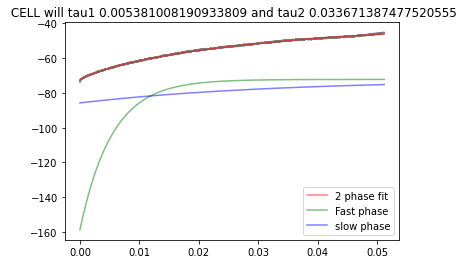

111
[[-86.0847   6.0465   0.0222 ...   0.1654   0.1343   1.7877]]
(7,)


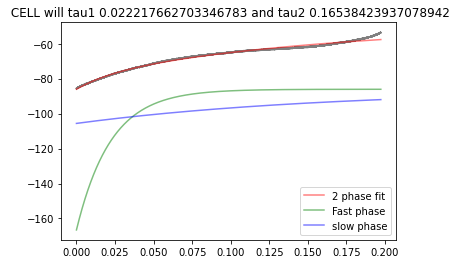

112
113
[[-69.369   98.6593   0.0071 ...   0.0071   1.       1.4366]]
(7,)


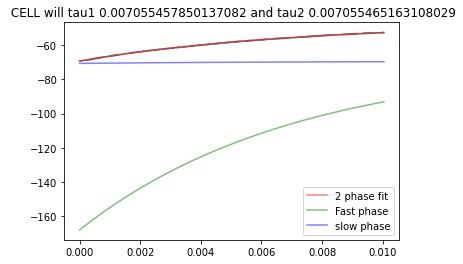

114
[[-98.8254  50.       0.0975 ...   0.5954   0.1637   0.0336]]
(7,)


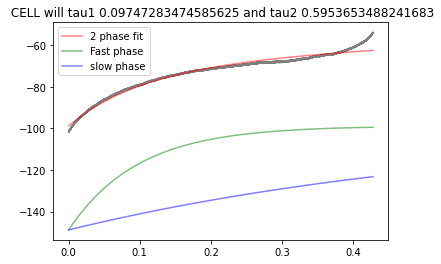

115
[[-94.9612  50.       0.0302 ...   0.0441   0.685    0.4534]]
(7,)


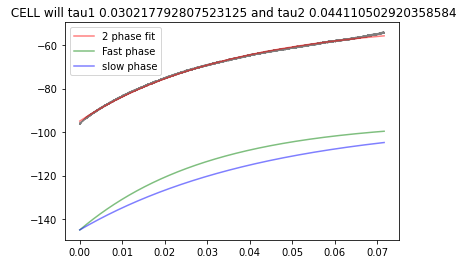

116
fail
117
[[-81.6446  80.4658   0.0555 ...   0.0555   1.       0.2238]]
(7,)


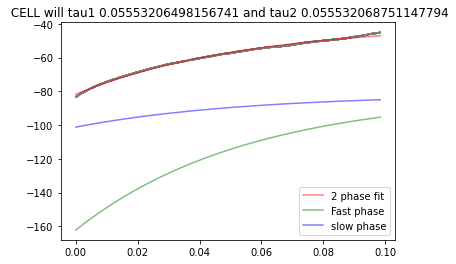

118
[[-81.131    8.1667   0.0143 ...   0.1224   0.1168   1.0329]]
(7,)


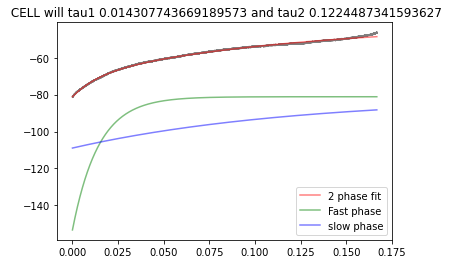

119
[[-95.6611   6.3312   0.0244 ...   0.1579   0.1544   1.2311]]
(7,)


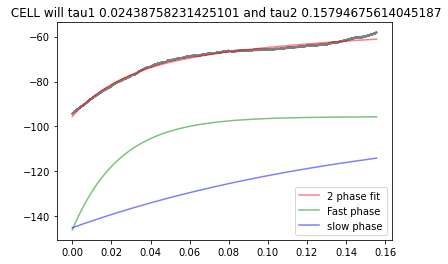

120
[[-67.2687  50.       0.0615 ...   0.1532   0.4014   0.1306]]
(7,)


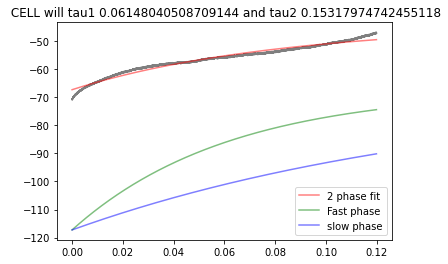

121
[[-87.5112   9.0145   0.0162 ...   0.1109   0.1457   0.8084]]
(7,)


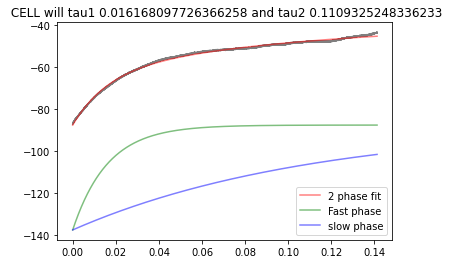

122
[[-107.3234   70.3007    0.0365 ...    0.3666    0.0995    0.0388]]
(7,)


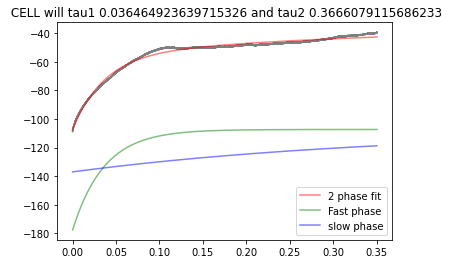

123
[[-88.9586  50.       0.0414 ...   0.1769   0.2337   0.1131]]
(7,)


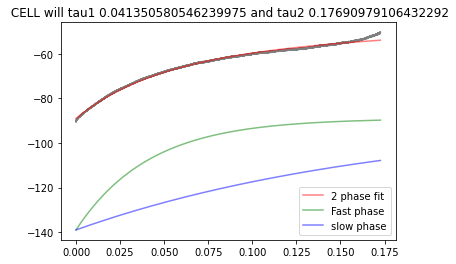

124
[[-89.1583  50.       0.0263 ...   0.1127   0.2331   0.1775]]
(7,)


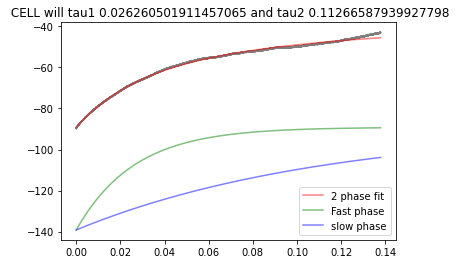

125
126
[[-87.3699  13.0465   0.0054 ...   0.0766   0.0704   0.5128]]
(7,)


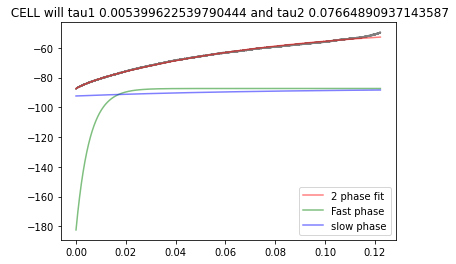

127
[[-83.254   36.0841   0.0277 ...   0.0277   1.       2.4458]]
(7,)


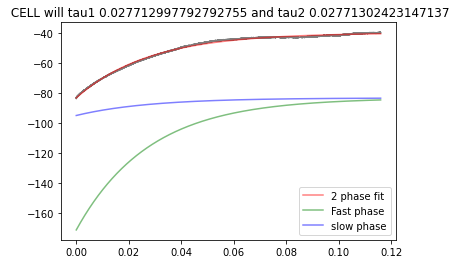

128
[[-82.1588  50.       0.0345 ...   0.0492   0.7015   0.4068]]
(7,)


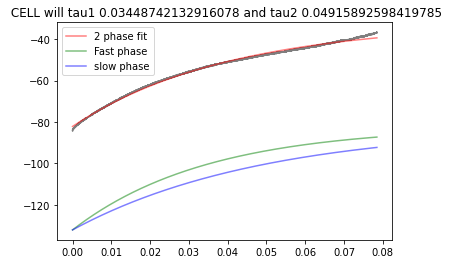

129
130
[[-104.849    50.        0.0534 ...    0.1051    0.5078    0.1903]]
(7,)


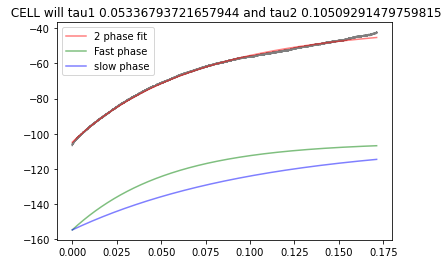

131
[[-88.2273  71.6529   0.0273 ...   0.2241   0.122    0.0623]]
(7,)


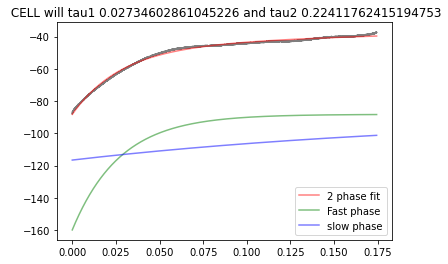

132
fail
133
[[-95.5879  14.1673   0.0161 ...   0.0706   0.2281   1.0702]]
(7,)


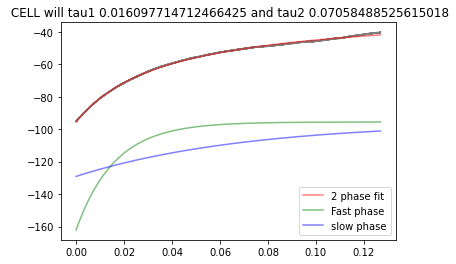

134
135
136
[[-78.2455  23.3995   0.0138 ...   0.0427   0.3228   0.8352]]
(7,)


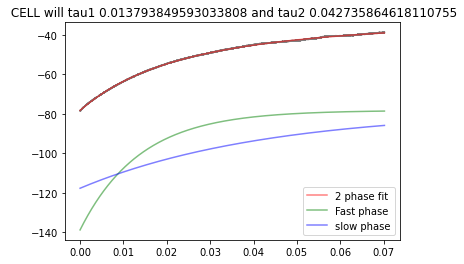

137
[[-84.5888  38.6959   0.0258 ...   0.0258   1.       2.5225]]
(7,)


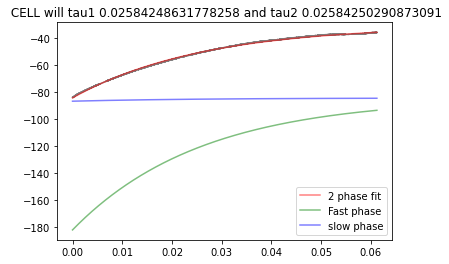

138
139
[[-77.5227  66.563    0.0087 ...   0.1554   0.0561   0.0967]]
(7,)


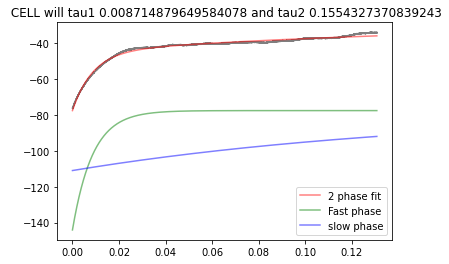

140
141
[[-82.5021  50.       0.0218 ...   0.0616   0.3542   0.3249]]
(7,)


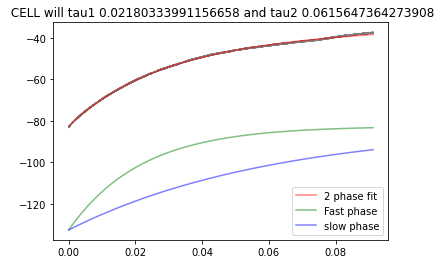

142
[[-78.2023  92.426    0.0313 ...   0.1643   0.1903   0.0658]]
(7,)


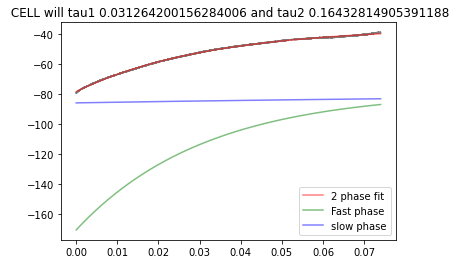

143
144
145
[[-91.4736  50.       0.055  ...   0.2547   0.2161   0.0785]]
(7,)


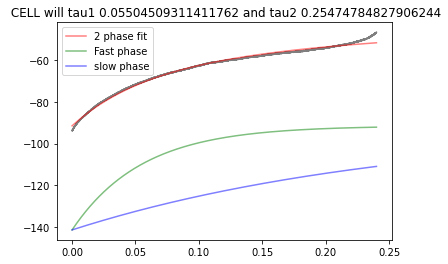

146
fail
147
[[-76.9631  50.       0.0545 ...   0.1508   0.3616   0.1326]]
(7,)


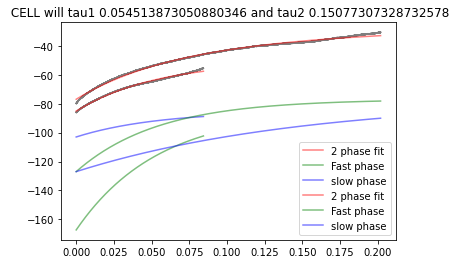

148
[[-111.6885   84.5551    0.0514 ...    0.0514    1.        0.23  ]]
(7,)


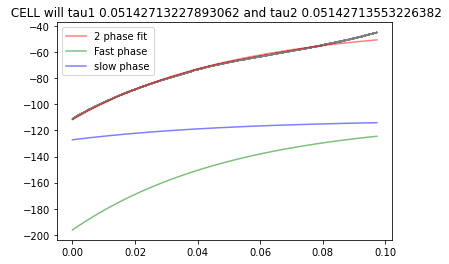

149
[[-132.7542   15.8436    0.0631 ...    0.0631    1.        5.152 ]]
(7,)


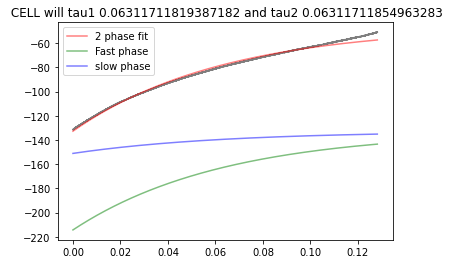

150
[[-104.597    20.6152    0.045  ...    0.0485    0.9281    4.5018]]
(7,)


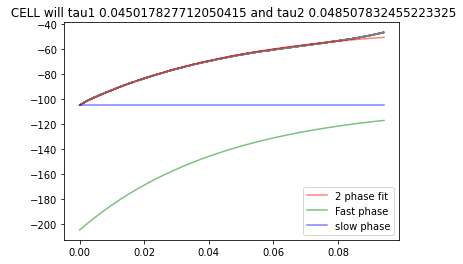

151
fail
152
[[-78.7026  78.9837   0.0604 ...   0.0604   1.       0.2096]]
(7,)


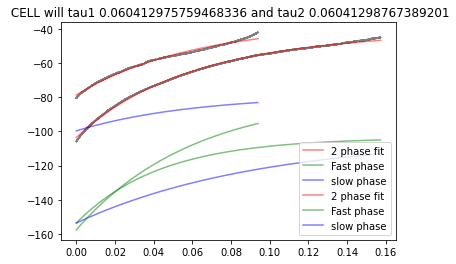

153
[[-82.4295  13.0433   0.0093 ...   0.0767   0.1215   0.7867]]
(7,)


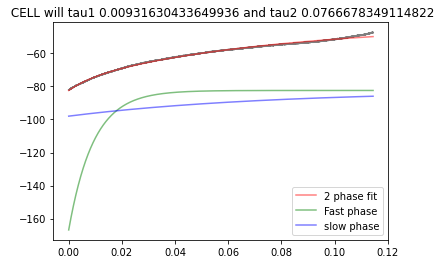

154
[[-83.9568  84.5519   0.043  ...   0.043    1.       0.2753]]
(7,)


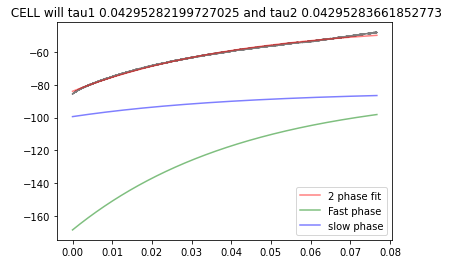

155
[[-85.5326  50.       0.0329 ...   0.0709   0.4632   0.2819]]
(7,)


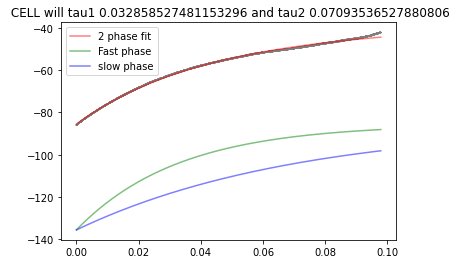

156
157
158
159
160
[[-82.0175  50.       0.024  ...   0.0764   0.3145   0.2617]]
(7,)


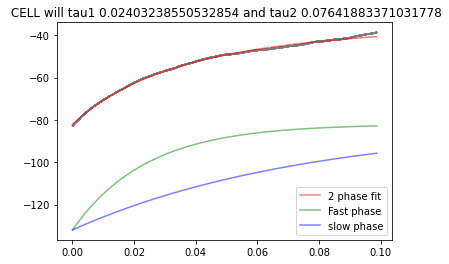

161
[[-92.1828  18.5558   0.0143 ...   0.0539   0.2652   1.1971]]
(7,)


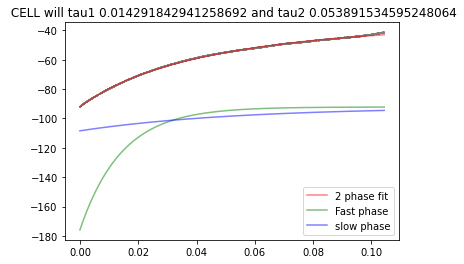

162
fail
163
[[-95.0056  50.       0.0443 ...   0.682    0.065    0.0293]]
(7,)


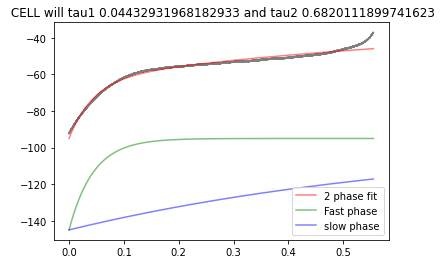

164
fail
165
[[-85.5318  25.2954   0.0395 ...   0.0395   1.       3.5829]]
(7,)


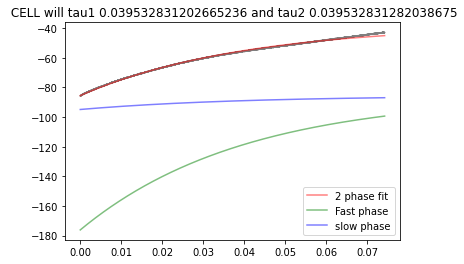

166
[[-85.2164  50.       0.0203 ...   0.0966   0.2103   0.2071]]
(7,)


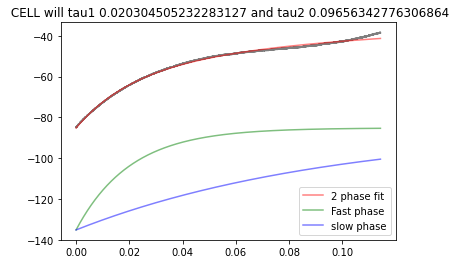

167
[[-81.3167  50.619    0.0163 ...   0.1953   0.0836   0.1012]]
(7,)


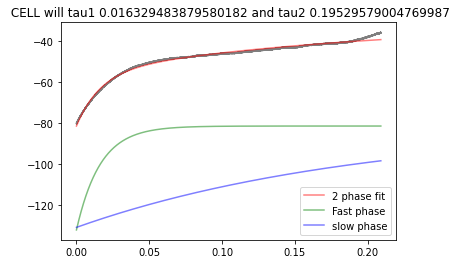

168
[[-75.6119  15.3512   0.012  ...   0.0651   0.1835   0.8877]]
(7,)


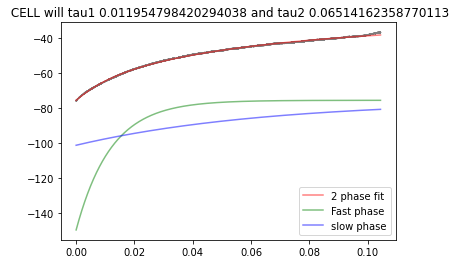

169
170
[[-78.6531  10.8183   0.0114 ...   0.0924   0.1229   0.5682]]
(7,)


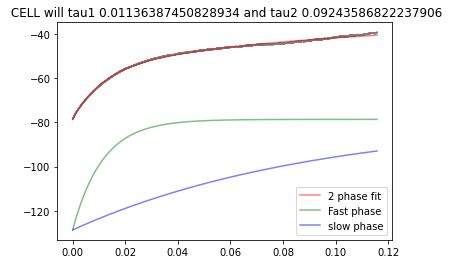

171
[[-97.375    7.926    0.0221 ...   0.1262   0.1753   1.1057]]
(7,)


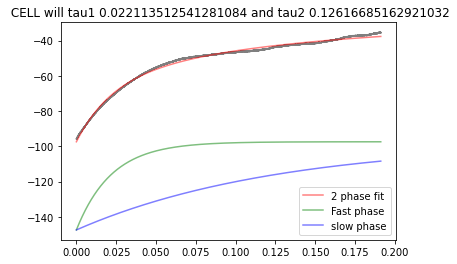

172
[[-78.5082  29.8229   0.0122 ...   0.0335   0.3647   0.6114]]
(7,)


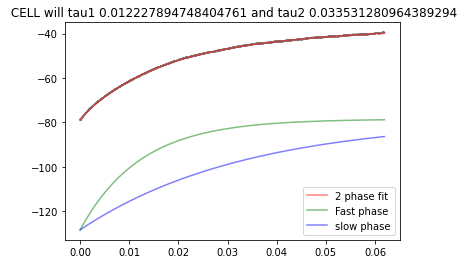

173
[[-89.7455  67.3056   0.0236 ...   0.4267   0.0553   0.0348]]
(7,)


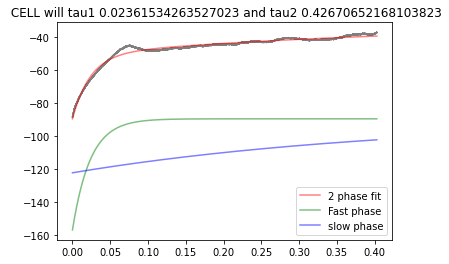

174
[[-108.5461   63.0991    0.0126 ...    0.4675    0.0269    0.0339]]
(7,)


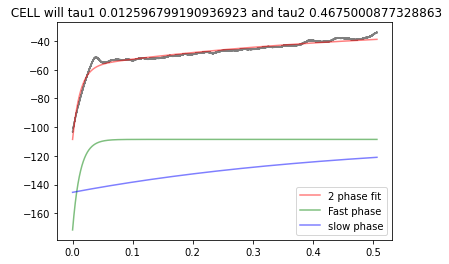

175
[[-75.4591  82.6848   0.0203 ...   0.0634   0.3204   0.1909]]
(7,)


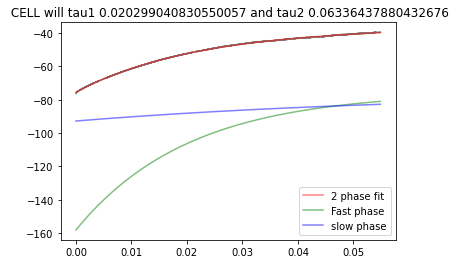

176
[[-77.0083  40.0861   0.0078 ...   0.0249   0.3122   0.3894]]
(7,)


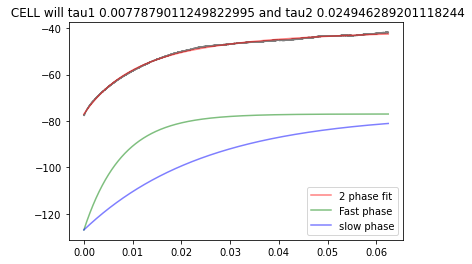

177
[[-78.9317  58.4308   0.0179 ...   0.1233   0.1454   0.1388]]
(7,)


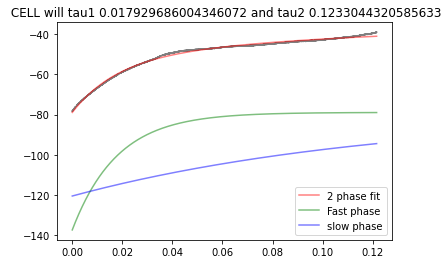

178
[[-95.3826 139.5793   0.0072 ...   0.0072   1.       0.7091]]
(7,)


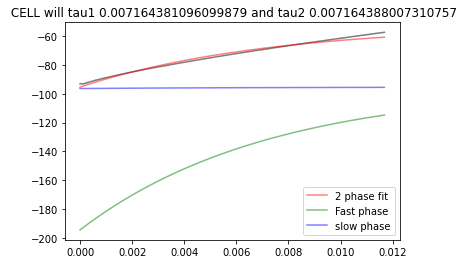

179
180
181
[[-102.0713   13.0157    0.0058 ...    0.0768    0.0759    0.5324]]
(7,)


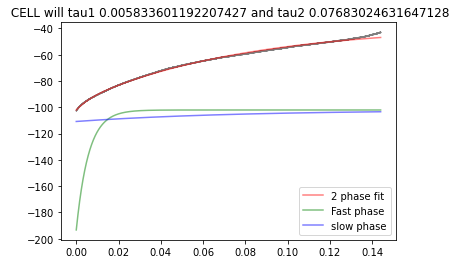

182
183
[[-80.5749  50.       0.0141 ...   0.0803   0.1754   0.2492]]
(7,)


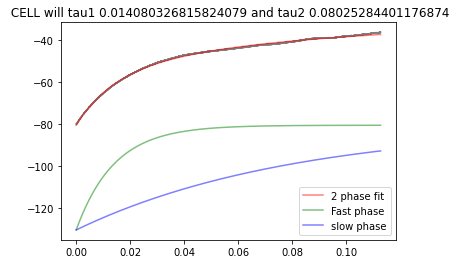

184
[[-100.2526   87.1721    0.0482 ...    0.0482    1.        0.2382]]
(7,)


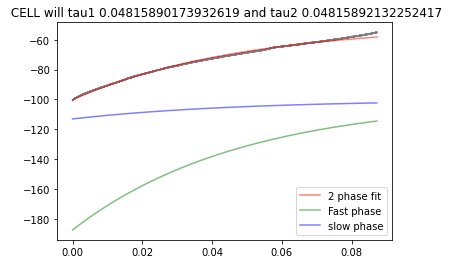

185
186
[[-92.4098  91.7461   0.0387 ...   0.0387   1.       0.2816]]
(7,)


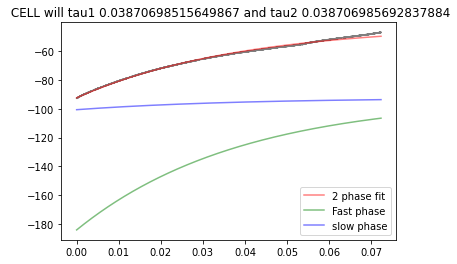

187
[[-81.1496  99.9048   0.034  ...   0.034    1.       0.2941]]
(7,)


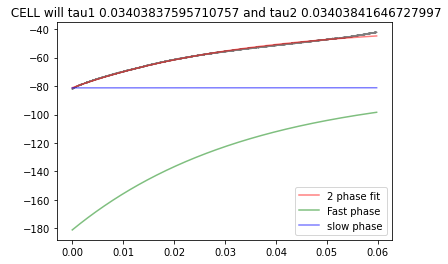

188
189
[[-127.0167   17.2754    0.0579 ...    0.0579    1.        5.2831]]
(7,)


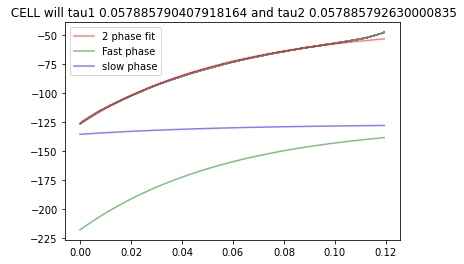

190
191
[[-90.7139  50.       0.0299 ...   0.1002   0.2981   0.1996]]
(7,)


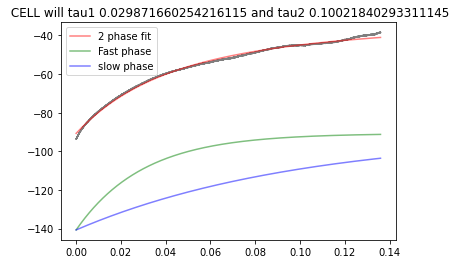

192
[[-88.1781  50.       0.0147 ...   0.1798   0.0819   0.1112]]
(7,)


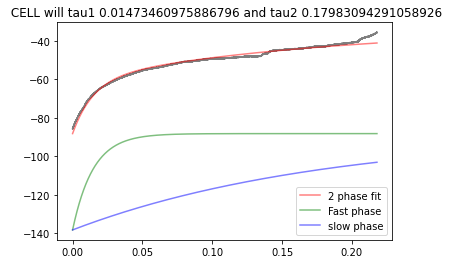

193
[[-129.491    50.        0.038  ...    0.1513    0.2513    0.1322]]
(7,)


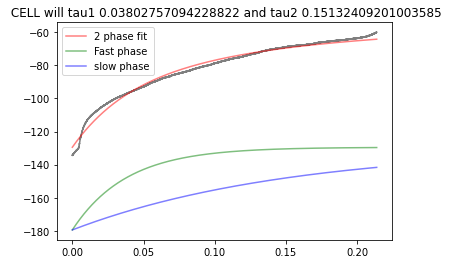

194
[[-112.6501   17.0248    0.0121 ...    0.0587    0.2061    1.1424]]
(7,)


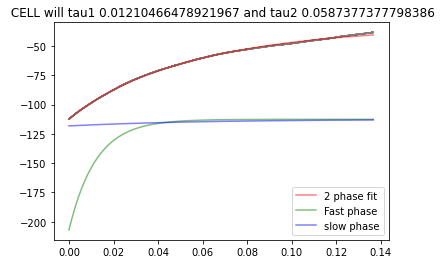

195
196
197
198
[[-77.3919  50.       0.0425 ...   0.122    0.3482   0.1639]]
(7,)


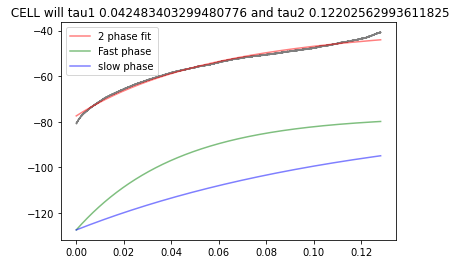

199
200
201
[[-93.485   95.4015   0.034  ...   0.034    1.       0.3086]]
(7,)


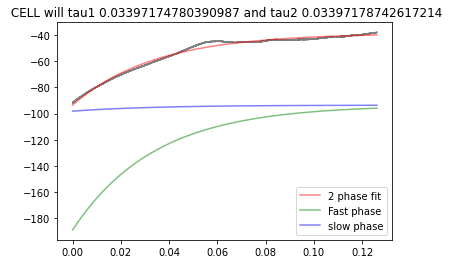

202
[[-98.8883  11.8129   0.0119 ...   0.0847   0.14     1.1251]]
(7,)


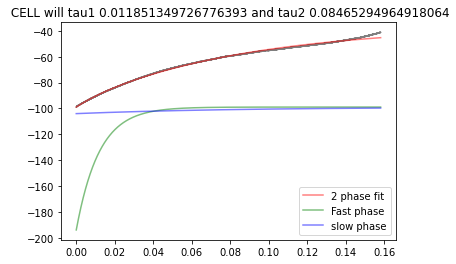

203
204
[[-78.0546  35.7442   0.0042 ...   0.028    0.1499   0.3816]]
(7,)


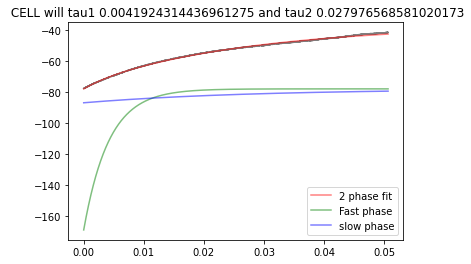

205
[[-108.3993   91.0829    0.0606 ...    0.0606    1.        0.1811]]
(7,)


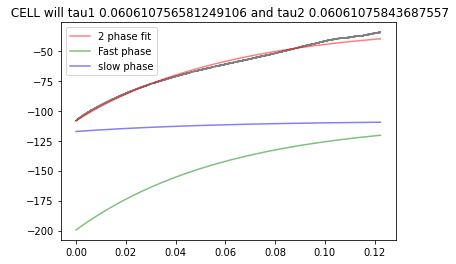

206
[[-95.8605  50.       0.0401 ...   0.1223   0.3277   0.1636]]
(7,)


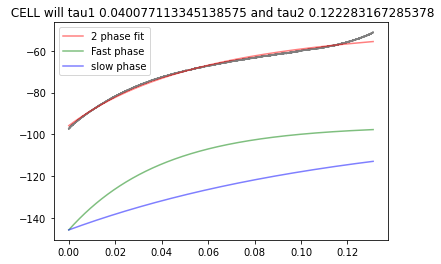

In [9]:
curves = []
label = []
ids = []
max_curve = []
for i, f in enumerate(files[:]):
    print(i)
    try:
        base = os.path.basename(f)
        base = base.split(".")[0]
        if base in file_names:
            x, y, c = loadABF(f)
            
            temp_curves =[]
            #plt.clf()
            iterd = 0
            for sweepX, sweepY, sweepC in zip(x,y,c):
                spikext = feature_extractor.SpikeFeatureExtractor(filter=0, end=1.25)
                res = spikext.process(sweepX, sweepY, sweepC)
                if res.empty==False and iterd < 1:
                    iterd += 1
                    spike_time = res['threshold_index'].to_numpy()[0]
                    #plt.figure(num=2)
                    curve, max_dy = exp_growth_factor(sweepX, sweepY, sweepC, spike_time)
                    max_curve.append(max_dy)
                    temp_curves.append(curve)
            temp_curves = np.vstack(temp_curves)
            div = np.ravel((temp_curves[:,2]) / (temp_curves[:,4])).reshape(-1,1)
            
            sum_height= (temp_curves[:,1] + temp_curves[:,3])
            ratio = (temp_curves[:,2] / (temp_curves[:,1] / sum_height)) / (temp_curves[:,4] / (temp_curves[:,3] / sum_height))
            ratio = np.ravel(ratio).reshape(-1,1)
            temp_curves = np.hstack([temp_curves, div, ratio])
            print(temp_curves)
            meanC = np.nanmean(temp_curves, axis=0)
            print(meanC.shape)
            curves.append(meanC)
            label_idx = np.argwhere(file_names==base)
            

            label.append(cell_type_label[label_idx])
            
            ids.append(base)
            plt.savefig(f+".png")
            plt.show()
            
            plt.close()
    except:
        print("fail")
curves = np.vstack(curves)

In [12]:
#lab = sklearn.preprocessing.LabelEncoder()
#int_lab = lab.fit_transform(label)
print(curves)
label = np.ravel(label).reshape(-1,1)
div = np.ravel((curves[:,2]) / (curves[:,4])).reshape(-1,1)
print(div)
sum_height= (curves[:,1] + curves[:,3])
ratio = (curves[:,2] / (curves[:,1]/sum_height)) / (curves[:,4] / (curves[:,3]/sum_height))
ratio = np.ravel(ratio).reshape(-1,1)
curves_out = np.hstack([curves, div, ratio, label])
np.savetxt('curves.csv', curves_out, fmt='%.8f', delimiter=',')
np.savetxt('curves_id.csv', ids, fmt='%s', delimiter=',')
print(curves)

[[ -70.9051   24.4667    0.0043 ...    0.0409    0.1046    0.2666]
 [-121.445    82.5704    0.0474 ...    0.0474    1.        0.2556]
 [ -90.1646   50.        0.0434 ...    0.0857    0.5066    0.2334]
 ...
 [ -78.0546   35.7442    0.0042 ...    0.028     0.1499    0.3816]
 [-108.3993   91.0829    0.0606 ...    0.0606    1.        0.1811]
 [ -95.8605   50.        0.0401 ...    0.1223    0.3277    0.1636]]
[[0.1046]
 [1.    ]
 [0.5066]
 ...
 [0.1499]
 [1.    ]
 [0.3277]]
[[ -70.9051   24.4667    0.0043 ...    0.0409    0.1046    0.2666]
 [-121.445    82.5704    0.0474 ...    0.0474    1.        0.2556]
 [ -90.1646   50.        0.0434 ...    0.0857    0.5066    0.2334]
 ...
 [ -78.0546   35.7442    0.0042 ...    0.028     0.1499    0.3816]
 [-108.3993   91.0829    0.0606 ...    0.0606    1.        0.1811]
 [ -95.8605   50.        0.0401 ...    0.1223    0.3277    0.1636]]


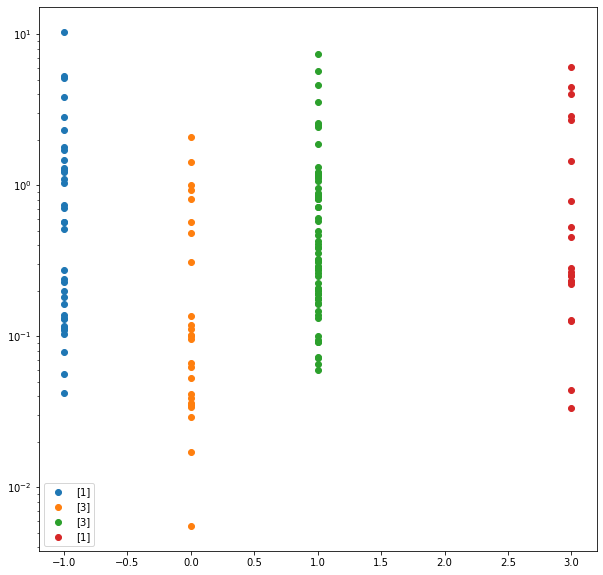

In [13]:
means = []
plt.figure(figsize=(10,10))
plt.clf()
for x in np.unique(label).astype(np.int64):
    idx = np.argwhere(label[:,0]==int(x)).astype(np.int32)
    mcur = curves[idx]
    plt.scatter(np.full(len(idx),  x),  ratio[idx], label=label[x])
    means.append(np.nanmean((curves[idx,2]) / (curves[idx,4])))
plt.legend()
plt.yscale('log')
#plt.ylim(0,1)

In [21]:
print(means)

[0.5009050316246025, 0.1542127203478362, 0.3948783626992154, 0.6311370707149823]
